In [56]:
#https://www.kaggle.com/saxinou/nlp-01-preprocessing-data
#https://www.kaggle.com/shaz13/feature-engineering-for-nlp-classification    

# Problem Statement

The task is to create simplified machine Learning model or deep learning to analyse feedback and identify key problems that are higlighted

To predict the topic level for reviews for the test file

# Importing Libraries

In [100]:
import pandas as pd
import numpy as np
import operator
from ngram import NGram
from nltk.tokenize import sent_tokenize, word_tokenize
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
import re
import string
from nltk import pos_tag
from nltk.tokenize import TweetTokenizer
import matplotlib.pyplot as plt; plt.rcdefaults()
import warnings
warnings.filterwarnings('ignore')
import nltk
nltk.download('stopwords')
import nltk
from collections import Counter
from nltk import tokenize
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shashank\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shashank\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

# Reading the files

In [101]:

train_df=pd.read_csv("C://Users//Shashank//Downloads//Open_cv_Assingment//DataSet//train.csv")
test_df=pd.read_csv("C://Users//Shashank//Downloads//Open_cv_Assingment//DataSet//test.csv")

In [102]:

print('Number of data   points in train data : ', train_df.shape[0])
print('Number of data points in test data : ', test_df.shape[0])
print('Number of features : ', train_df.shape[1])
print('Features : ', train_df.columns.values)


Number of data   points in train data :  5959
Number of data points in test data :  2553
Number of features :  3
Features :  ['Review Text' 'Review Title' 'topic']


# Preprocessing of the data

In [103]:
#Renaming the column names in both train and test data
train_df.rename(columns = {'Review Text':'Rev_text','Review Title':'Rev_title'},inplace=True)
test_df.rename(columns = {'Review Text':'Rev_text','Review Title':'Rev_title'},inplace=True)

In [104]:
train_df.head(5)

,Rev_text,Rev_title,topic
0,"Did nothing for me, didn't help lost even with...",Useless,Shipment and delivery
1,"Did nothing for me, didn't help lost even with...",Useless,Not Effective
2,I have bought these bags and immediately open...,TRASH!!! Do not buy these bags it’s a waist of...,Customer Service
3,Gave me an allergic reaction on my face :(,Do not recommend,Allergic
4,These don't compare to the name brand wipes. F...,Can't tackle big messes,Texture


In [105]:
test_df.head(5)

,Rev_text,Rev_title
0,I use chia seed in my protein shakes. These ta...,Bad tast
1,I use chia seed in my protein shakes. These ta...,Bad tast
2,Don’t waste your money.,No change. No results.
3,I use the book 'Fortify Your Life' by Tieraona...,"Good Vegan Choice, Poor Non Vegan Choice"
4,I use the book 'Fortify Your Life' by Tieraona...,"Good Vegan Choice, Poor Non Vegan Choice"


In [106]:
#train_df["Rev_text_backup"] = train_df["Rev_text"] #Creating new column text_backup same as text.
#test_df["Rev_title_backup"] = test_df["Rev_title"] #Creating new column text_backup same as text.

# Checking for the missing values

In [107]:
#Checking for the missing values
missing_data = pd.DataFrame({'total_missing': train_df.isnull().sum(), 'perc_missing': (train_df.isnull().sum()/6000)*100})
missing_data

,total_missing,perc_missing
Rev_text,0,0.0
Rev_title,0,0.0
topic,0,0.0


From above observation it can be concluded that there are no missing values in the data

# Checking for duplicates


In [108]:
train_df.drop_duplicates(keep='first',inplace=True)

In [109]:
test_df.drop_duplicates(keep='first',inplace=True)

In [110]:
#Checking data types of the column
train_df.dtypes

Rev_text     object
Rev_title    object
topic        object
dtype: object

In [111]:
train_df.topic.value_counts()

Bad Taste/Flavor           1193
Quality/Contaminated        712
Not Effective               610
Allergic                    567
Packaging                   466
Texture                     410
Shipment and delivery       388
Customer Service            239
Color and texture           233
Too big to swallow          228
Ingredients                 215
Expiry                      135
Smells Bad                  123
Pricing                     107
Wrong Product received       99
Too Sweet                    97
Inferior to competitors      44
False Advertisement          37
Didn't Like                  31
Customer Issues               8
Hard to Chew                  6
Name: topic, dtype: int64

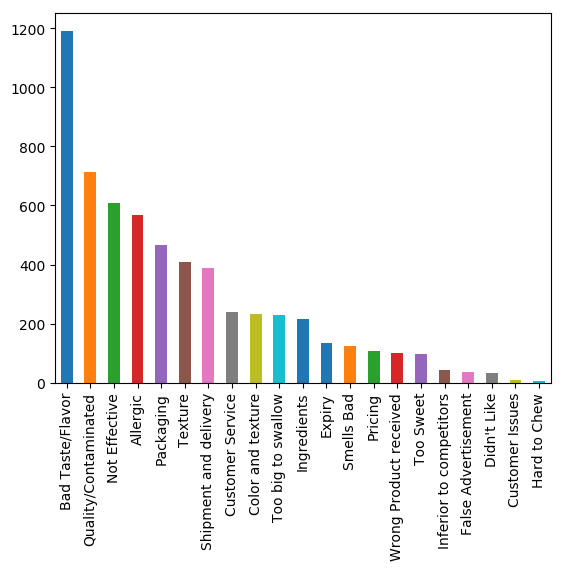

In [112]:
train_df.topic.value_counts().plot.bar()

From the above graph it clearly states that the dataset is imbalanced.We will look for it later depending on situation what to do

In [113]:
# merging the columns Rev_text and Rev_title
train_df['merged_rev'] = train_df[['Rev_text', 'Rev_title']].apply(lambda x: ''.join(x), axis=1)
test_df['merged_rev'] = test_df[['Rev_text', 'Rev_title']].apply(lambda x: ''.join(x), axis=1)


In [114]:
#dropping the columns
train_df.drop(['Rev_text', 'Rev_title'], axis = 1,inplace=True)

In [115]:
#dropping the columns
test_df.drop(['Rev_text','Rev_title'],axis=1,inplace=True)

In [116]:
train_df["merged_rev_backup"] = train_df["merged_rev"] #Creating new column text_backup same as text.
test_df["merged_rev_backup"] = test_df["merged_rev"] #Creating new column text_backup same as text.

In [117]:
train_df.head(20)

,topic,merged_rev,merged_rev_backup
0,Shipment and delivery,"Did nothing for me, didn't help lost even with...","Did nothing for me, didn't help lost even with..."
1,Not Effective,"Did nothing for me, didn't help lost even with...","Did nothing for me, didn't help lost even with..."
2,Customer Service,I have bought these bags and immediately open...,I have bought these bags and immediately open...
3,Allergic,Gave me an allergic reaction on my face :(Do n...,Gave me an allergic reaction on my face :(Do n...
4,Texture,These don't compare to the name brand wipes. F...,These don't compare to the name brand wipes. F...
5,Quality/Contaminated,These don't compare to the name brand wipes. F...,These don't compare to the name brand wipes. F...
6,Color and texture,These don't compare to the name brand wipes. F...,These don't compare to the name brand wipes. F...
7,Bad Taste/Flavor,No goodTastes horrible,No goodTastes horrible
8,Too big to swallow,These are EXTREMELY hard to swallow. The pills...,These are EXTREMELY hard to swallow. The pills...
9,Quality/Contaminated,First of all the style I am leaving a review f...,First of all the style I am leaving a review f...


In [118]:
test_df.head(5)

,merged_rev,merged_rev_backup
0,I use chia seed in my protein shakes. These ta...,I use chia seed in my protein shakes. These ta...
2,Don’t waste your money.No change. No results.,Don’t waste your money.No change. No results.
3,I use the book 'Fortify Your Life' by Tieraona...,I use the book 'Fortify Your Life' by Tieraona...
5,I used to be loyal customer to this brand. I h...,I used to be loyal customer to this brand. I h...
9,I haven’t received it yet.Shipping,I haven’t received it yet.Shipping


# Feature Engineering

In [119]:
#for train data
from tqdm import tqdm # I love this handy tool! 
print(">> Generating Count Based And Demographical Features")
for df in ([train_df]):
    train_df['length'] = train_df['merged_rev'].apply(lambda x : len(x))
    
    # Count of characters in a statement
    train_df['count_of_char'] = train_df["merged_rev"].apply(lambda x: len(str(x)))
    

    train_df['capitals'] = train_df['merged_rev'].apply(lambda comment: sum(1 for c in comment if c.isupper()))
    train_df['caps_vs_length'] = train_df.apply(lambda row: float(row['capitals'])/float(row['length']),axis=1)
    train_df['num_exclamation_marks'] = train_df['merged_rev'].apply(lambda comment: comment.count('!'))
    train_df['num_question_marks'] = train_df['merged_rev'].apply(lambda comment: comment.count('?'))
    train_df['num_punctuation'] = train_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in '.,;:'))
    train_df['num_symbols'] = train_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in '*&$%'))
    train_df['num_words'] = train_df['merged_rev'].apply(lambda comment: len(comment.split()))
    train_df['num_unique_words'] = train_df['merged_rev'].apply(lambda comment: len(set(w for w in comment.split())))
    #Diversity_score i.e. Average length of words used in statement
    train_df['avg_len_of_word'] = train_df['count_of_char'] / train_df['num_words']
    #test_df['avg_len_of_word'] = test_df['count_of_char'] / test_df['num_words']
    train_df['words_vs_unique'] = train_df['num_unique_words'] / df['num_words']
    train_df['num_smilies'] = train_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in (':-)', ':)', ';-)', ';)')))
    train_df['num_sad'] = train_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in (':-<', ':()', ';-()', ';(')))
#The usage of stop words can be another writing pattern. So the fourth feature is count of stopwords.
#Count of stopwords in the sentence.
    stop_words = set(stopwords.words('english'))
    train_df['count_of_stop_words'] = train_df["merged_rev"].apply(lambda x: len([w for w in str(x).lower().split() if w in stop_words]) )
    #test_df['Feature_4'] = test_df["merged_rev"].apply(lambda x: len([w for w in str(x).lower().split() if w in stop_words]) )

#Let us identify the highest used words(other than stopwords) in our input data for further feature generation.

#getting all text in single list: Though there are several other quicker options to do this, but
#this is the most accurate and convenient of them.
    all_text_without_sw = ''
    for i in train_df.itertuples():
        all_text_without_sw = all_text_without_sw +  str(i.merged_rev)
        
    
   #getting counts of each words:
    counts = Counter(re.findall(r"[\w']+", all_text_without_sw))
   #deleting ' from counts
    del counts["'"]
   #getting top 50 used words:
    sorted_x = dict(sorted(counts.items(), key=operator.itemgetter(1),reverse=True)[:50])
   #Feature-5: The count of top used words.
    train_df['top_used_words'] = train_df['merged_rev'].apply(lambda x: len([w for w in str(x).lower().split() if w in sorted_x]) )
    #test_df[

>> Generating Count Based And Demographical Features


In [120]:
#Similarly lets identify the least used words:
reverted_x = dict(sorted(counts.items(), key=operator.itemgetter(1))[:10000])
# The count of least used words.
train_df['least_used_words'] = train_df['merged_rev'].apply(lambda x: len([w for w in str(x).lower().split() if w in reverted_x]) )


In [121]:
#Function for getting Trigram from text:
def ngram_list_from_string(string1,count_of_words_in_ngram):
    string1 = string1.lower()
    string1 = string1.replace('.','. ')
    all_grams = NGram(string1.split(), count_of_words_in_ngram)
    grams_list = []
    for grams in all_grams:
        grams_list.append(grams)
    return(grams_list)


In [122]:
#Getting Trigram for text:
ngram_list = ngram_list_from_string(all_text_without_sw,3)

#Getting count for every ngram:
ngram_counts = Counter(ngram_list)

#Getting top 10 ngram as per highest count:
sorted_ngram = dict(sorted(ngram_counts.items(), key=operator.itemgetter(1),reverse=True)[:10])

#Feature-14: Top 10 trigram occurence:
train_df['trigram_occ'] = train_df['merged_rev'].apply(lambda x: len([w for w in ngram_list_from_string(x,3)if w in sorted_ngram]) )


ValueError: threshold out of range 0.0 to 1.0: 3

# print word cloud for top used words

Let's have glance at some new features

In [124]:
train_df[train_df.columns[2:]].head(5)

,merged_rev_backup,length,count_of_char,capitals,caps_vs_length,num_exclamation_marks,num_question_marks,num_punctuation,num_symbols,num_words,num_unique_words,avg_len_of_word,words_vs_unique,num_smilies,num_sad,count_of_stop_words,top_used_words,least_used_words
0,"Did nothing for me, didn't help lost even with...",119,119,3,0.025210,0,0,3,0,19,19,6.263158,1.000000,0,0,8,4,1
1,"Did nothing for me, didn't help lost even with...",119,119,3,0.025210,0,0,3,0,19,19,6.263158,1.000000,0,0,8,4,1
2,I have bought these bags and immediately open...,297,297,10,0.033670,6,0,2,0,58,43,5.120690,0.741379,0,0,29,21,0
3,Gave me an allergic reaction on my face :(Do n...,58,58,2,0.034483,0,0,1,0,11,11,5.272727,1.000000,0,0,5,4,0
4,These don't compare to the name brand wipes. F...,341,341,6,0.017595,0,0,7,0,64,56,5.328125,0.875000,0,0,27,20,2


In [125]:
#for train data
from tqdm import tqdm # I love this handy tool! 
print(">> Generating Count Based And Demographical Features")
for df in ([test_df]):
    test_df['length'] = test_df['merged_rev'].apply(lambda x : len(x))
    
    # Count of characters in a statement
    test_df['count_of_char'] = test_df["merged_rev"].apply(lambda x: len(str(x)))
    

    test_df['capitals'] = test_df['merged_rev'].apply(lambda comment: sum(1 for c in comment if c.isupper()))
    test_df['caps_vs_length'] = test_df.apply(lambda row: float(row['capitals'])/float(row['length']),axis=1)
    test_df['num_exclamation_marks'] = test_df['merged_rev'].apply(lambda comment: comment.count('!'))
    test_df['num_question_marks'] = test_df['merged_rev'].apply(lambda comment: comment.count('?'))
    test_df['num_punctuation'] = test_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in '.,;:'))
    test_df['num_symbols'] = test_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in '*&$%'))
    test_df['num_words'] = test_df['merged_rev'].apply(lambda comment: len(comment.split()))
    test_df['num_unique_words'] = test_df['merged_rev'].apply(lambda comment: len(set(w for w in comment.split())))
    #Diversity_score i.e. Average length of words used in statement
    test_df['avg_len_of_word'] = test_df['count_of_char'] / train_df['num_words']
    
    test_df['words_vs_unique'] = test_df['num_unique_words'] / df['num_words']
    test_df['num_smilies'] = test_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in (':-)', ':)', ';-)', ';)')))
    test_df['num_sad'] = test_df['merged_rev'].apply(lambda comment: sum(comment.count(w) for w in (':-<', ':()', ';-()', ';(')))
#The usage of stop words can be another writing pattern. So the fourth feature is count of stopwords.
#Count of stopwords in the sentence.
    stop_words = set(stopwords.words('english'))
    test_df['count_of_stop_words'] = test_df["merged_rev"].apply(lambda x: len([w for w in str(x).lower().split() if w in stop_words]) )
    #test_df['Feature_4'] = test_df["merged_rev"].apply(lambda x: len([w for w in str(x).lower().split() if w in stop_words]) )

#Let us identify the highest used words(other than stopwords) in our input data for further feature generation.

#getting all text in single list: 
    all_text_without_sw = ''
    for i in train_df.itertuples():
        all_text_without_sw = all_text_without_sw +  str(i.merged_rev)
        
    
   #getting counts of each words:
    counts = Counter(re.findall(r"[\w']+", all_text_without_sw))
   #deleting ' from counts
    del counts["'"]
   #getting top 50 used words:
    sorted_x = dict(sorted(counts.items(), key=operator.itemgetter(1),reverse=True)[:50])
   #Feature-5: The count of top used words.
    test_df['top_used_words'] = test_df['merged_rev'].apply(lambda x: len([w for w in str(x).lower().split() if w in sorted_x]) )
    #test_df['top_used_words'] = test_df['top_used_words'].apply(lambda x: len([w for w in str(x).lower().split() if w in sorted_x]) )

>> Generating Count Based And Demographical Features


In [126]:
test_df[test_df.columns[2:]].head(5)

,length,count_of_char,capitals,caps_vs_length,num_exclamation_marks,num_question_marks,num_punctuation,num_symbols,num_words,num_unique_words,avg_len_of_word,words_vs_unique,num_smilies,num_sad,count_of_stop_words,top_used_words
0,95,95,4,0.042105,0,0,2,0,18,18,5.000000,1.000000,0,0,7,6
2,45,45,3,0.066667,0,0,3,0,7,7,0.775862,1.000000,0,0,2,1
3,2055,2055,81,0.039416,0,0,44,2,351,194,186.818182,0.552707,0,0,156,126
5,428,428,21,0.049065,1,0,8,0,82,62,6.687500,0.756098,0,0,36,30
9,34,34,2,0.058824,0,0,1,0,5,5,0.108280,1.000000,0,0,2,1


In [127]:
#Similarly lets identify the least used words:
reverted_x = dict(sorted(counts.items(), key=operator.itemgetter(1))[:10000])
# The count of least used words.
test_df['least_used_words'] = test_df['merged_rev'].apply(lambda x: len([w for w in str(x).lower().split() if w in reverted_x]) )


# Tagging Parts Of Speech And More Feature Engineering..

In [128]:

def tag_part_of_speech(text):
    text_splited = text.split(' ')
    text_splited = [''.join(c for c in s if c not in string.punctuation) for s in text_splited]
    text_splited = [s for s in text_splited if s]
    pos_list = pos_tag(text_splited)
    noun_count = len([w for w in pos_list if w[1] in ('NN','NNP','NNPS','NNS')])
    adjective_count = len([w for w in pos_list if w[1] in ('JJ','JJR','JJS')])
    verb_count = len([w for w in pos_list if w[1] in ('VB','VBD','VBG','VBN','VBP','VBZ')])
    return[noun_count, adjective_count, verb_count]

In [129]:
print(">> Generating POS Features")
for df in ([train_df]):
    train_df['nouns'], train_df['adjectives'], train_df['verbs'] = zip(*train_df['merged_rev'].apply(
        lambda comment: tag_part_of_speech(comment)))
    train_df['nouns_vs_length'] = train_df['nouns'] / train_df['length']
    train_df['adjectives_vs_length'] = train_df['adjectives'] / train_df['length']
    train_df['verbs_vs_length'] = train_df['verbs'] /train_df['length']
    train_df['nouns_vs_words'] = train_df['nouns'] / train_df['num_words']
    train_df['adjectives_vs_words'] = train_df['adjectives'] / train_df['num_words']
    train_df['verbs_vs_words'] = train_df['verbs'] / train_df['num_words']
    # More Handy Features
    train_df["count_words_title"] = train_df["merged_rev"].apply(lambda x: len([w for w in str(x).split() if w.istitle()]))
    train_df["mean_word_len"] = train_df["merged_rev"].apply(lambda x: np.mean([len(w) for w in str(x).split()]))
    #train_df['punct_percent']= train_df['merged_rev']*100/df['num_words']

>> Generating POS Features


In [130]:
train_df[train_df.columns[2:]].head(5)

,merged_rev_backup,length,count_of_char,capitals,caps_vs_length,num_exclamation_marks,num_question_marks,num_punctuation,num_symbols,num_words,...,adjectives,verbs,nouns_vs_length,adjectives_vs_length,verbs_vs_length,nouns_vs_words,adjectives_vs_words,verbs_vs_words,count_words_title,mean_word_len
0,"Did nothing for me, didn't help lost even with...",119,119,3,0.025210,0,0,3,0,19,...,1,4,0.058824,0.008403,0.033613,0.368421,0.052632,0.210526,1,5.315789
1,"Did nothing for me, didn't help lost even with...",119,119,3,0.025210,0,0,3,0,19,...,1,4,0.058824,0.008403,0.033613,0.368421,0.052632,0.210526,1,5.315789
2,I have bought these bags and immediately open...,297,297,10,0.033670,6,0,2,0,58,...,2,11,0.050505,0.006734,0.037037,0.258621,0.034483,0.189655,4,4.120690
3,Gave me an allergic reaction on my face :(Do n...,58,58,2,0.034483,0,0,1,0,11,...,1,2,0.051724,0.017241,0.034483,0.272727,0.090909,0.181818,2,4.363636
4,These don't compare to the name brand wipes. F...,341,341,6,0.017595,0,0,7,0,64,...,11,10,0.049853,0.032258,0.029326,0.265625,0.171875,0.156250,5,4.343750


# Some more preprocessing

In [131]:
uri_re = r'(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:\'".,<>?«»“”‘’]))'

def stripTagsAndUris(x):
    if x:
        # BeautifulSoup on content
        soup = BeautifulSoup(x, "html.parser")
        # Stripping all <code> tags with their content if any
        if soup.code:
            soup.code.decompose()
        # Get all the text out of the html
        text =  soup.get_text()
        # Returning text stripping out all uris
        return re.sub(uri_re, "", text)
    else:
        return ""

In [132]:
train_df['merged_rev_backup'] = train_df.apply(lambda x: stripTagsAndUris(x['merged_rev_backup']),axis=1)

# Removing contractions

In [133]:
"""
Expanding contraction 
"""
contraction_dict = {"ain't": "is not", "aren't": "are not","can't": "cannot", 
                   "can't've": "cannot have", "'cause": "because", "could've": "could have", 
                   "couldn't": "could not", "couldn't've": "could not have","didn't": "did not", 
                   "doesn't": "does not", "don't": "do not", "hadn't": "had not", 
                   "hadn't've": "had not have", "hasn't": "has not", "haven't": "have not", 
                   "he'd": "he would", "he'd've": "he would have", "he'll": "he will", 
                   "he'll've": "he he will have", "he's": "he is", "how'd": "how did", 
                   "how'd'y": "how do you", "how'll": "how will", "how's": "how is", 
                   "I'd": "I would", "I'd've": "I would have", "I'll": "I will", 
                   "I'll've": "I will have","I'm": "I am", "I've": "I have", 
                   "i'd": "i would", "i'd've": "i would have", "i'll": "i will", 
                   "i'll've": "i will have","i'm": "i am", "i've": "i have", 
                   "isn't": "is not", "it'd": "it would", "it'd've": "it would have", 
                   "it'll": "it will", "it'll've": "it will have","it's": "it is", 
                   "let's": "let us", "ma'am": "madam", "mayn't": "may not", 
                   "might've": "might have","mightn't": "might not","mightn't've": "might not have", 
                   "must've": "must have", "mustn't": "must not", "mustn't've": "must not have", 
                   "needn't": "need not", "needn't've": "need not have","o'clock": "of the clock",
                   "oughtn't": "ought not", "oughtn't've": "ought not have", "shan't": "shall not",
                   "sha'n't": "shall not", "shan't've": "shall not have", "she'd": "she would", 
                   "she'd've": "she would have", "she'll": "she will", "she'll've": "she will have", 
                   "she's": "she is", "should've": "should have", "shouldn't": "should not", 
                   "shouldn't've": "should not have", "so've": "so have","so's": "so as", 
                   "this's": "this is",
                   "that'd": "that would", "that'd've": "that would have","that's": "that is", 
                   "there'd": "there would", "there'd've": "there would have","there's": "there is", 
                   "they'd": "they would", "they'd've": "they would have", "they'll": "they will", 
                   "they'll've": "they will have", "they're": "they are", "they've": "they have", 
                   "to've": "to have", "wasn't": "was not", "we'd": "we would", 
                   "we'd've": "we would have", "we'll": "we will", "we'll've": "we will have", 
                   "we're": "we are", "we've": "we have", "weren't": "were not", 
                   "what'll": "what will", "what'll've": "what will ",
                   "what're": "what are", 
                   "what's": "what is", "what've": "what have", "when's": "when is", 
                   "when've": "when have", "where'd": "where did", "where's": "where is", 
                   "where've": "where have", "who'll": "who will", "who'll've": "who will have", 
                   "who's": "who is", "who've": "who have", "why's": "why is", 
                   "why've": "why have", "will've": "will have", "won't": "will not", 
                   "won't've": "will not have", "would've": "would have", "wouldn't": "would not", 
                   "wouldn't've": "would not have", "y'all": "you all", "y'all'd": "you all would",
                   "y'all'd've": "you all would have","y'all're": "you all are","y'all've": "you all have",
                   "you'd": "you would", "you'd've": "you would have", "you'll": "you will", 
                   "you'll've": "you will have", "you're": "you are", "you've": "you have" } 
                   

In [142]:
def _get_contractions(contraction_dict):
    contraction_re = re.compile('(%s)' % '|'.join(contraction_dict.keys()))
    return contraction_dict, contraction_re

contractions, contractions_re = _get_contractions(contraction_dict)

def replace_contractions(text):
    def replace(match):
        return contractions[match.group(0)]
    return contractions_re.sub(replace, text)

# Usage
for index, text in train_df.iterrows(): 
    print (train_df["merged_rev_backup"]) 
     


0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my lights, these are a big disappointment....
17      [Absol

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

Name: merged_rev_backup, Length: 5948, dtype: object
0       [Did nothing for me, didn't help lost even wit...
1       [Did nothing for me, didn't help lost even wit...
2       [I have bought these bags and  immediately ope...
3       [Gave me an allergic reaction on my face :(Do ...
4       [These don't compare to the name brand wipes.,...
5       [These don't compare to the name brand wipes.,...
6       [These don't compare to the name brand wipes.,...
7                                [No goodTastes horrible]
8       [These are EXTREMELY hard to swallow., The pil...
9       [First of all the style I am leaving a review ...
10      [First of all the style I am leaving a review ...
11      [First of all the style I am leaving a review ...
12      [These smelled horrible!, As soon as I opened ...
13      [Super easy these don’t work and definitely do...
14      [Super easy these don’t work and definitely do...
15      [By my lights, these are a big disappointment....
16      [By my ligh

In [136]:
def custom_tokenize(text):
    if not text:
        print('The text to be tokenized is a None type. Defaulting to blank string.')
        text = ''
    return sent_tokenize(text)
#train_df['merged_rev_backup'] = train_df.merged_rev_backup.apply(custom_tokenize)

In [144]:
def expand_contractions(sentence, contraction_mapping): 
     
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())),  
                                      flags=re.IGNORECASE|re.DOTALL) 
    def expand_match(contraction): 
        match = contraction.group(0) 
        first_char = match[0] 
        expanded_contraction = contraction_mapping.get(match) if contraction_mapping.get(match) else contraction_mapping.get(match.lower())                        
        expanded_contraction = first_char+expanded_contraction[1:] 
        return expanded_contraction 
         
    expanded_sentence = contractions_pattern.sub(expand_match, sentence) 
    return expanded_sentence 
     

data = train_df.apply(lambda row: nltk.word_tokenize(train_df["merged_rev_backup"]), axis=1)
expanded_corpus = [expand_contractions(train_df['merged_rev_backup'].values, contraction_dict)  
                     for txt in sent_tokenize(train_df.apply(lambda row: str(row["merged_rev_backup"] )), axis = 1)]     

#print ("Text before expanding contraction : \n ", text1)
print ("\n Text after expanding contraction : \n ",expanded_corpus) 

TypeError: ('expected string or bytes-like object', 'occurred at index 0')

In [56]:
print(">> Generating POS Features")
for df in ([test_df]):
    test_df['nouns'], test_df['adjectives'], test_df['verbs'] = zip(*test_df['merged_rev'].apply(
        lambda comment: tag_part_of_speech(comment)))
    test_df['nouns_vs_length'] = test_df['nouns'] / test_df['length']
    test_df['adjectives_vs_length'] = test_df['adjectives'] / test_df['length']
    test_df['verbs_vs_length'] = test_df['verbs'] /test_df['length']
    test_df['nouns_vs_words'] = test_df['nouns'] / test_df['num_words']
    test_df['adjectives_vs_words'] = test_df['adjectives'] / test_df['num_words']
    test_df['verbs_vs_words'] = test_df['verbs'] / test_df['num_words']
    # More Handy Features
    test_df["count_words_title"] = test_df["merged_rev"].apply(lambda x: len([w for w in str(x).split() if w.istitle()]))
    test_df["mean_word_len"] = test_df["merged_rev"].apply(lambda x: np.mean([len(w) for w in str(x).split()]))
    #test_df['punct_percent']= test_df['merged_rev']*100/df['num_words']
    test_df['avg_len_of_word'] = test_df['count_of_char'] / test_df['num_words']

>> Generating POS Features


In [57]:
test_df[test_df.columns[2:]].head(5)

,length,count_of_char,capitals,caps_vs_length,num_exclamation_marks,num_question_marks,num_punctuation,num_symbols,num_words,num_unique_words,...,adjectives,verbs,nouns_vs_length,adjectives_vs_length,verbs_vs_length,nouns_vs_words,adjectives_vs_words,verbs_vs_words,count_words_title,mean_word_len
0,95,95,4,0.042105,0,0,2,0,18,18,...,2,5,0.042105,0.021053,0.052632,0.222222,0.111111,0.277778,3,4.333333
2,45,45,3,0.066667,0,0,3,0,7,7,...,0,1,0.088889,0.000000,0.022222,0.571429,0.000000,0.142857,1,5.571429
3,2055,2055,81,0.039416,0,0,44,2,351,194,...,30,59,0.057421,0.014599,0.028710,0.336182,0.085470,0.168091,71,4.806268
5,428,428,21,0.049065,1,0,8,0,82,62,...,6,19,0.037383,0.014019,0.044393,0.195122,0.073171,0.231707,8,4.231707
9,34,34,2,0.058824,0,0,1,0,5,5,...,0,3,0.000000,0.000000,0.088235,0.000000,0.000000,0.600000,1,6.000000


In [23]:
test_df['merged_rev']=test_df.apply(lambda x: stripTagsAndUris(x['merged_rev']),axis=1)

# Removing Contractions

Contraction are shortened version of words or syllables. They exist in either written or spoken forms. By nature, contraction pose a problem for NLP and text analysis because we have a special apostrophe character in the word. Plus we have two or more words represented by a contraction, and this opens a whole new can of worms when we try to tokenize this or even standardize the words. Hence, there should be some definitve process by which we can deal with contractions when processing text. Ideally, one  can have a proper mapping for contractions and their corresponding expansions and then use it to expand all the contractions in our text.

In [61]:
"""
Expanding contraction 
"""
CONTRACTION_MAP = {"ain't": "is not", "aren't": "are not","can't": "cannot", 
                   "can't've": "cannot have", "'cause": "because", "could've": "could have", 
                   "couldn't": "could not", "couldn't've": "could not have","didn't": "did not", 
                   "doesn't": "does not", "don't": "do not", "hadn't": "had not", 
                   "hadn't've": "had not have", "hasn't": "has not", "haven't": "have not", 
                   "he'd": "he would", "he'd've": "he would have", "he'll": "he will", 
                   "he'll've": "he he will have", "he's": "he is", "how'd": "how did", 
                   "how'd'y": "how do you", "how'll": "how will", "how's": "how is", 
                   "I'd": "I would", "I'd've": "I would have", "I'll": "I will", 
                   "I'll've": "I will have","I'm": "I am", "I've": "I have", 
                   "i'd": "i would", "i'd've": "i would have", "i'll": "i will", 
                   "i'll've": "i will have","i'm": "i am", "i've": "i have", 
                   "isn't": "is not", "it'd": "it would", "it'd've": "it would have", 
                   "it'll": "it will", "it'll've": "it will have","it's": "it is", 
                   "let's": "let us", "ma'am": "madam", "mayn't": "may not", 
                   "might've": "might have","mightn't": "might not","mightn't've": "might not have", 
                   "must've": "must have", "mustn't": "must not", "mustn't've": "must not have", 
                   "needn't": "need not", "needn't've": "need not have","o'clock": "of the clock", 
                   "oughtn't": "ought not", "oughtn't've": "ought not have", "shan't": "shall not",
                   "sha'n't": "shall not", "shan't've": "shall not have", "she'd": "she would", 
                   "she'd've": "she would have", "she'll": "she will", "she'll've": "she will have", 
                   "she's": "she is", "should've": "should have", "shouldn't": "should not", 
                   "shouldn't've": "should not have", "so've": "so have","so's": "so as", 
                   "this's": "this is",
                   "that'd": "that would", "that'd've": "that would have","that's": "that is", 
                   "there'd": "there would", "there'd've": "there would have","there's": "there is", 
                   "they'd": "they would", "they'd've": "they would have", "they'll": "they will", 
                   "they'll've": "they will have", "they're": "they are", "they've": "they have", 
                   "to've": "to have", "wasn't": "was not", "we'd": "we would", 
                   "we'd've": "we would have", "we'll": "we will", "we'll've": "we will have", 
                   "we're": "we are", "we've": "we have", "weren't": "were not", 
                   "what'll": "what will", "what'll've": "what will have", "what're": "what are", 
                   "what's": "what is", "what've": "what have", "when's": "when is", 
                   "when've": "when have", "where'd": "where did", "where's": "where is", 
                   "where've": "where have", "who'll": "who will", "who'll've": "who will have", 
                   "who's": "who is", "who've": "who have", "why's": "why is", 
                   "why've": "why have", "will've": "will have", "won't": "will not", 
                   "won't've": "will not have", "would've": "would have", "wouldn't": "would not", 
                   "wouldn't've": "would not have", "y'all": "you all", "y'all'd": "you all would",
                   "y'all'd've": "you all would have","y'all're": "you all are","y'all've": "you all have",
                   "you'd": "you would", "you'd've": "you would have", "you'll": "you will", 
                   "you'll've": "you will have", "you're": "you are", "you've": "you have" } 

In [65]:
def expand_contractions(sentence, contraction_mapping): 
     
    contractions_pattern = re.compile('({})'.format('|'.join(contraction_mapping.keys())),  
                                      flags=re.IGNORECASE|re.DOTALL) 
    def expand_match(contraction): 
        match = contraction.group(0) 
        first_char = match[0] 
        expanded_contraction = contraction_mapping.get(match) if contraction_mapping.get(match) else contraction_mapping.get(match.lower())                        
        expanded_contraction = first_char+expanded_contraction[1:] 
        return expanded_contraction 
         
    expanded_sentence = contractions_pattern.sub(expand_match, sentence) 
    return expanded_sentence 
     
expanded_corpus = [expand_contractions(train_df['merged_rev'].values, CONTRACTION_MAP)  
                     for txt in sent_tokenize(text1)]     

print ("Text before expanding contraction : \n ", text1)
print ("\n Text after expanding contraction : \n ",expanded_corpus) 

NameError: name 'text1' is not defined

# Removing punctuations from titles 

In [23]:
def removePunctuation(x):
    # Lowercasing all words
    x = x.lower()
    # Removing non ASCII chars
    x = re.sub(r'[^\x00-\x7f]',r' ',x)
    # Removing (replacing with empty spaces actually) all the punctuations
    return re.sub("["+string.punctuation+"]", " ", x)

In [24]:
train_df['merged_rev'] = train_df.apply(lambda x: removePunctuation(x['merged_rev']),axis=1)
test_df['merged_rev'] = test_df.apply(lambda x: removePunctuation(x['merged_rev']),axis=1)

In [25]:
train_df['topic'] = train_df.apply(lambda x: removePunctuation(x['topic']),axis=1)

# Removing stopwords from titles and cntents

In [26]:
import nltk
nltk.download('stopwords')
stops = set(stopwords.words("english"))
def removeStopwords(x):
    # Removing all the stopwords
    filtered_words = [word for word in x.split() if word not in stops]
    return " ".join(filtered_words)

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/shashankkumarmishra/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [27]:
train_df['merged_rev'] = test_df.apply(lambda x: removeStopwords(x['merged_rev']),axis=1)

# Removing contractions

Contraction are shortened version of words or syllables. They exist in either written or spoken forms. By nature, contraction pose a problem for NLP and text analysis because we have a special apostrophe character in the word. Plus we have two or more words represented by a contraction, and this opens a whole new can of worms when we try to tokenize this or even standardize the words. Hence, there should be some definitve process by which we can deal with contractions when processing text. Ideally, one  can have a proper mapping for contractions and their corresponding expansions and then use it to expand all the contractions in our text.

In [33]:
"""
Expanding contraction 
"""
CONTRACTION_MAP = {"ain't": "is not", "aren't": "are not","can't": "cannot", 
                   "can't've": "cannot have", "'cause": "because", "could've": "could have", 
                   "couldn't": "could not", "couldn't've": "could not have","didn't": "did not", 
                   "doesn't": "does not", "don't": "do not", "hadn't": "had not", 
                   "hadn't've": "had not have", "hasn't": "has not", "haven't": "have not", 
                   "he'd": "he would", "he'd've": "he would have", "he'll": "he will", 
                   "he'll've": "he he will have", "he's": "he is", "how'd": "how did", 
                   "how'd'y": "how do you", "how'll": "how will", "how's": "how is", 
                   "I'd": "I would", "I'd've": "I would have", "I'll": "I will", 
                   "I'll've": "I will have","I'm": "I am", "I've": "I have", 
                   "i'd": "i would", "i'd've": "i would have", "i'll": "i will", 
                   "i'll've": "i will have","i'm": "i am", "i've": "i have", 
                   "isn't": "is not", "it'd": "it would", "it'd've": "it would have", 
                   "it'll": "it will", "it'll've": "it will have","it's": "it is", 
                   "let's": "let us", "ma'am": "madam", "mayn't": "may not", 
                   "might've": "might have","mightn't": "might not","mightn't've": "might not have", 
                   "must've": "must have", "mustn't": "must not", "mustn't've": "must not have", 
                   "needn't": "need not", "needn't've": "need not have","o'clock": "of the clock", 
                   "oughtn't": "ought not", "oughtn't've": "ought not have", "shan't": "shall not",
                   "sha'n't": "shall not", "shan't've": "shall not have", "she'd": "she would", 
                   "she'd've": "she would have", "she'll": "she will", "she'll've": "she will have", 
                   "she's": "she is", "should've": "should have", "shouldn't": "should not", 
                   "shouldn't've": "should not have", "so've": "so have","so's": "so as", 
                   "this's": "this is",
                   "that'd": "that would", "that'd've": "that would have","that's": "that is", 
                   "there'd": "there would", "there'd've": "there would have","there's": "there is", 
                   "they'd": "they would", "they'd've": "they would have", "they'll": "they will", 
                   "they'll've": "they will have", "they're": "they are", "they've": "they have", 
                   "to've": "to have", "wasn't": "was not", "we'd": "we would", 
                   "we'd've": "we would have", "we'll": "we will", "we'll've": "we will have", 
                   "we're": "we are", "we've": "we have", "weren't": "were not", 
                   "what'll": "what will", "what'll've": "what will have", "what're": "what are", 
                   "what's": "what is", "what've": "what have", "when's": "when is", 
                   "when've": "when have", "where'd": "where did", "where's": "where is", 
                   "where've": "where have", "who'll": "who will", "who'll've": "who will have", 
                   "who's": "who is", "who've": "who have", "why's": "why is", 
                   "why've": "why have", "will've": "will have", "won't": "will not", 
                   "won't've": "will not have", "would've": "would have", "wouldn't": "would not", 
                   "wouldn't've": "would not have", "y'all": "you all", "y'all'd": "you all would",
                   "y'all'd've": "you all would have","y'all're": "you all are","y'all've": "you all have",
                   "you'd": "you would", "you'd've": "you would have", "you'll": "you will", 
                   "you'll've": "you will have", "you're": "you are", "you've": "you have" } 

In [39]:
"""
Method 1 : Using the brown corpus in NLTK and "in" operator
"""

nltk.download('brown')
from nltk.corpus import brown
word_list = brown.words()
len(word_list)

word_set = set(word_list)
"looked" in word_set

[nltk_data] Downloading package brown to
[nltk_data]     /home/shashankkumarmishra/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.


True

In [44]:
def correct_word_in_sentence(text):
    tokens = nltk.word_tokenize(text)
    r = [correction(token) for token in tokens]
    return (r)


In [46]:
tmp = ' '.join(correct_word_in_sentence(train_df['merged_rev'].values))
type(tmp)
print(tmp)

TypeError: buffer size mismatch

# Number of unique words

In [31]:
    train_df['num_unique_words'] = train_df['merged_rev'].progress_apply(lambda comment: len(set(w for w in comment.split())))

AttributeError: 'Series' object has no attribute 'progress_apply'

In [27]:
train_df['num_words'] = train_df.merged_rev.str.count('\S+')

In [28]:
train_df.head(5)

,topic,merged_rev,num_words
0,Shipment and delivery,"Did nothing for me, didn't help lost even with...",19
1,Not Effective,"Did nothing for me, didn't help lost even with...",19
2,Customer Service,I have bought these bags and immediately open...,58
3,Allergic,Gave me an allergic reaction on my face :(Do n...,11
4,Texture,These don't compare to the name brand wipes. F...,64
